In [1]:
#Классический набор
import numpy as np
import pandas as pd

#Первоначальная визуализация
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

# Кодирование
from category_encoders import TargetEncoder, OrdinalEncoder

#Обработка данных
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PowerTransformer

# Чтобы сделать все красиво
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer

#Нужная метрика и прочее для построения моделей
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV, KFold

#Классификаторы
from sklearn.linear_model import LogisticRegression
from catboost import CatBoostClassifier
from xgboost import XGBClassifier
import xgboost as xgb
from lightgbm import LGBMClassifier

# Игнорируем всё
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

In [2]:
pip freeze > requirements.txt

Note: you may need to restart the kernel to use updated packages.


### 1. Импорт файла и рассуждения

In [2]:
df_train = pd.read_csv('X_train.csv', sep=',', index_col='index')
y_train = pd.read_csv('y_train.csv', sep=',', index_col='index')
df_test = pd.read_csv('X_test.csv', index_col='index')

In [3]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1199861 entries, 0 to 1199860
Data columns (total 44 columns):
 #   Column                      Non-Null Count    Dtype  
---  ------                      --------------    -----  
 0   acc_now_delinq              1199861 non-null  float64
 1   addr_state                  1199861 non-null  object 
 2   annual_inc                  1199861 non-null  float64
 3   chargeoff_within_12_mths    1199824 non-null  float64
 4   collections_12_mths_ex_med  1199824 non-null  float64
 5   delinq_2yrs                 1199861 non-null  float64
 6   dti                         1199861 non-null  float64
 7   earliest_cr_line            1199861 non-null  object 
 8   emp_length                  1128114 non-null  object 
 9   fico_range_high             1199861 non-null  float64
 10  fico_range_low              1199861 non-null  float64
 11  funded_amnt                 1199861 non-null  float64
 12  home_ownership              1199861 non-null  object 
 1

В исходном файле всего 44 признака, таргет импортируется отдельно. Всего 1 199 861 наблюдений.

Первоначально в трейновой выборке наблюдается 12 категориальных признаков и 32 численных. Допустим.

In [4]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 590977 entries, 0 to 590976
Data columns (total 44 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   acc_now_delinq              590977 non-null  float64
 1   addr_state                  590977 non-null  object 
 2   annual_inc                  590977 non-null  float64
 3   chargeoff_within_12_mths    590958 non-null  float64
 4   collections_12_mths_ex_med  590958 non-null  float64
 5   delinq_2yrs                 590977 non-null  float64
 6   dti                         590977 non-null  float64
 7   earliest_cr_line            590977 non-null  object 
 8   emp_length                  555347 non-null  object 
 9   fico_range_high             590977 non-null  float64
 10  fico_range_low              590977 non-null  float64
 11  funded_amnt                 590977 non-null  float64
 12  home_ownership              590977 non-null  object 
 13  inq_last_12m  

В тестовой выборке всё аналогично с признаками, однако, в ней также присутстствуют пропуски. В дальнейшем это необходимо учитывать.

In [5]:
df_train.describe(include='object')

,addr_state,earliest_cr_line,emp_length,home_ownership,int_rate,issue_d,purpose,revol_util,term,title,verification_status,zip_code
count,1199861,1199861,1128114,1199861,1199861,1199861,1199861,1199020,1199861,1186061,1199861,1199860
unique,51,748,11,6,669,160,14,1316,2,43858,3,936
top,CA,Sep-2003,10+ years,MORTGAGE,10.99%,Mar-2016,debt_consolidation,0%,36 months,Debt consolidation,Source Verified,945xx
freq,171589,8116,396911,584286,28586,37886,684522,6612,903699,602886,478709,12979


12 категориальных признаков. Исходя из файла с описанием данных они содержат в себе следующую информацию:

* addr_state - Штат, указанный заемщиком в кредитной заявке
* earliest_cr_line - Месяц открытия самой ранней из заявленных кредитных карт заемщика
* emp_length - Продолжительность трудовой деятельности в годах (Возможные значения - от 0 до 10, где 0 означает менее одного года, а 10 - десять и более лет)
* home_ownership - Статус владельца жилья, указанный заемщиком при регистрации или полученный из кредитного отчета (Значениями являются: АРЕНДА, СОБСТВЕННОЕ, ИПОТЕКА, ДРУГОЕ)
* int_rate - Процентная ставка по кредиту
* issue_d - Месяц, когда кредит был предоставлен
* purpose - Категория (цели), указанная заемщиком в заявке на кредит
* revol_util - Коэффициент использования возобновляемой задолженности, или сумма кредита, которую заемщик использует по отношению ко всем доступным возобновляемым займам
* term - Количество платежей по кредиту (Значения указываются в месяцах и могут составлять 36 или 60)
* title - Наименование кредита, предоставленного заемщиком
* verification_status - Указывает, был ли доход проверен оператором, не был он проверен, или был ли проверен источник дохода
* zip_code - Первые 3 цифры почтового индекса, указанного заемщиком в кредитной заявке.

Таким образом, на мой взгляд можно рассмотреть следующие варианты преобразования категориальных данных:
1) TargetEncoder для addr_state, home_ownership, purpose
2) OrdinalEncoder для emp_length (<1 years = 0, ..., >10 years= 20 (пропуски я бы заполнила -1))
3) Преобразование в числовые данные для int_rate и revol_util (убрав %), для zip_code убрав хх в конце
4) Преобразование дат. Если даты играют роль -?. Для earliest_cr_line и issue_d: разделить на два новых признака (месяц указать числом, год указать отдельно)
5) Самое непростое - title. Как будто бы наименование кредита - важно, но 43 858 уникальных значений звучит дико. Нужно узнать в чем дело

Необходимо объединить тестовую и обучающую выборку, чтобы преобразования проводить единоразово:

In [6]:
full_df = pd.concat([df_train, df_test])
full_df.index = [i for i in range(len(full_df))]
#Запоминаем индекс разделения обучающей и тестовой выборки
idx_split = df_train.shape[0]

In [7]:
full_df['int_rate'] = full_df['int_rate'].str.replace('%', '')
full_df['revol_util'] = full_df['revol_util'].str.replace('%', '')
full_df['zip_code'] = full_df['zip_code'].str.replace('xx', '')
full_df[['int_rate','revol_util','zip_code']]

,int_rate,revol_util,zip_code
0,12.99,56.1,847
1,10.42,88.3,900
2,8.99,18.1,895
3,11.53,33.4,853
4,26.30,88.6,453
...,...,...,...
1790833,9.17,68.7,916
1790834,13.99,54.5,601
1790835,14.65,67.7,431
1790836,7.62,29.8,088


Преобразуем их в числовые:

In [8]:
full_df['int_rate'] = full_df['int_rate'].astype (float)
full_df['revol_util'] = full_df['revol_util'].astype (float)
#Заменю в признаке zip_code один пропуск на нули
full_df['zip_code'].fillna(0, inplace = True)
full_df['zip_code'] = full_df['zip_code'].astype (int)

In [9]:
full_df[['earliest_cr_line_month', 'earliest_cr_line_year']] = full_df['earliest_cr_line']. str.split('-', 1 , expand= True )
full_df[['issue_d_month', 'issue_d_year']] = full_df['issue_d']. str.split('-', 1 , expand= True)

In [10]:
full_df['earliest_cr_line_year'] = full_df['earliest_cr_line_year'].astype (int)
full_df['issue_d_year'] = full_df['issue_d_year'].astype (int)

Ага, если честно, наименование кредита - полная лажа, так как написано всё подряд, пожалуй, лучше отказаться от этого признака.

Эту информацию вносили заёмщики, подавая заявку, поэтому там можно встретить числа, девизы, года. Как будто смысла тут немного, если учесть, что есть отдельный признак purpose, который означает цель кредита. Можно предположить, что чем больше символов в строке, которую ввёл субъект, тем больше желание получить кредит, но это сомнительно. Но перебирать 43 тысячи строк ещё сомнительнее.

Удаляю столбцы из категориальных, которые больше не нужны:

In [11]:
full_df.drop(columns = ['title','earliest_cr_line','issue_d'],axis = 1, inplace=True)

Перевожу "липовые" float в int:

In [12]:
full_df['acc_now_delinq'] = full_df['acc_now_delinq'].astype (int)
full_df['delinq_2yrs'] = full_df['delinq_2yrs'].astype (int)
full_df['fico_range_high'] = full_df['fico_range_high'].astype (int)
full_df['fico_range_low'] = full_df['fico_range_low'].astype (int)
full_df['funded_amnt'] = full_df['funded_amnt'].astype (int)
full_df['loan_amnt'] = full_df['loan_amnt'].astype (int)
full_df['open_acc'] = full_df['open_acc'].astype (int)
full_df['pub_rec'] = full_df['pub_rec'].astype (int)
full_df['total_acc'] = full_df['total_acc'].astype (int)

Проверка на дубликаты:

In [13]:
df_train.duplicated().sum()

0

Дубликаты в обучающей выборке не наблюдаются.

Обратим внимание на пропуски в данных:

In [14]:
missing = df_train.isnull().sum()[df_train.isnull().sum() > 0].sort_values()
print('Количество признаков, которые имеют пропуски в обучающей выборке:',missing.count())
missing

Количество признаков, которые имеют пропуски в обучающей выборке: 24


zip_code                           1
tax_liens                         28
chargeoff_within_12_mths          37
collections_12_mths_ex_med        37
pub_rec_bankruptcies             467
revol_util                       841
title                          13800
mort_acc                       31541
num_sats                       37295
percent_bc_gt_75               44334
num_tl_op_past_12m             45009
num_tl_90g_dpd_24m             45009
num_tl_30dpd                   45009
num_actv_bc_tl                 45009
num_accts_ever_120_pd          45009
num_rev_accts                  45010
emp_length                     71747
num_tl_120dpd_2m               90608
mths_since_recent_inq         149781
open_il_24m                   567214
open_rv_24m                   567214
inq_last_12m                  567215
mths_since_last_delinq        607443
mths_since_recent_bc_dlq      917196
dtype: int64

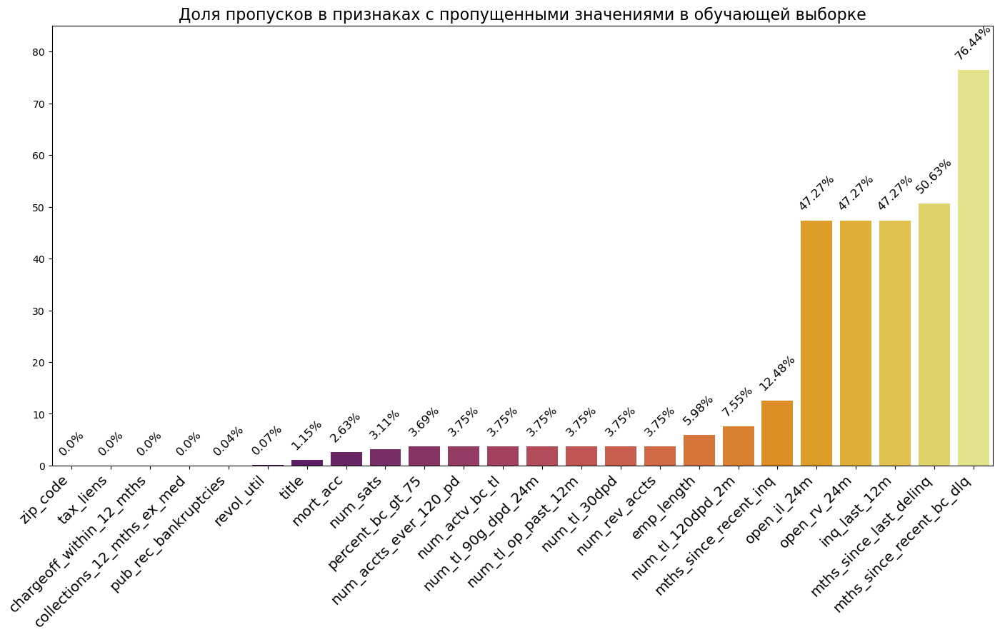

In [15]:
missing_per = (missing/len(df_train)*100).sort_values()

plt.figure(figsize=(17, 8))
bar = sns.barplot(x=missing_per.index, y=missing_per, palette='inferno')
for i in range(24):
    plt.text(i, missing_per[i] + 2, f'{round(missing_per[i], 2)}%', fontsize=12, ha='center',rotation=45)
    bar.set_xticklabels(bar.get_xticklabels(), rotation=45, horizontalalignment='right', fontweight='light', fontsize='x-large')
plt.ylim([0, 85])
plt.title("Доля пропусков в признаках с пропущенными значениями в обучающей выборке", fontsize=16);

Таким образом, больше половины числовых признаков имеют в себе пропуски, с которыми так или иначе придётся бороться.

Признак mths_since_recent_bc_dlq будто бы имеет смысл отбросить вовсе. Слишком много пропусков.

In [16]:
missing = df_test.isnull().sum()[df_test.isnull().sum() > 0].sort_values()
print('Количество признаков, которые имеют пропуски в тестовой выборке:',missing.count())
missing

Количество признаков, которые имеют пропуски в тестовой выборке: 23


tax_liens                         11
chargeoff_within_12_mths          19
collections_12_mths_ex_med        19
pub_rec_bankruptcies             230
revol_util                       413
title                           6844
mort_acc                       15740
num_sats                       18546
percent_bc_gt_75               22075
num_tl_op_past_12m             22518
num_tl_30dpd                   22518
num_tl_90g_dpd_24m             22518
num_actv_bc_tl                 22518
num_accts_ever_120_pd          22518
num_rev_accts                  22518
emp_length                     35630
num_tl_120dpd_2m               45008
mths_since_recent_inq          74110
open_il_24m                   278909
open_rv_24m                   278909
inq_last_12m                  278909
mths_since_last_delinq        299829
mths_since_recent_bc_dlq      451967
dtype: int64

Список аналогичный обучающей выборке, даже порядок одинаковый. Это хорошо.

Пропуски, но int:
* chargeoff_within_12_mths - Количество списаний в течение 12 месяцев.
* collections_12_mths_ex_med - Количество взысканий за 12 месяцев, за исключением взысканий по медицинским показаниям.
* inq_last_12m - Количество кредитных запросов за последние 12 месяцев.
* mort_acc - Количество ипотечных счетов
* mths_since_last_delinq - Количество месяцев, прошедших с момента последней просрочки заемщика.
* mths_since_recent_bc_dlq - Месяцев с момента последней просрочки по банковской карте.
* mths_since_recent_inq - Месяцев с момента последнего запроса.
* num_accts_ever_120_pd - Количество счетов, просроченных на 120 и более дней.
* num_actv_bc_tl - Количество активных в настоящее время счетов банковских карт.
* num_rev_accts - Количество возобновляемых счетов.
* num_sats - Количество открытых удовлетворительных счетов.
* num_tl_120dpd_2m - Количество счетов, просроченных на 120 дней (обновлено за последние 2 месяца).
* num_tl_30dpd - Количество счетов, просроченных на 30 дней (обновлено за последние 2 месяца).
* num_tl_90g_dpd_24m - Количество счетов, просроченных на 90 и более дней за последние 24 месяца.
* num_tl_op_past_12m - Количество счетов, открытых за последние 12 месяцев.
* open_il_24m - Количество счетов рассрочки, открытых за последние 24 месяца.
* open_rv_24m - Количество возобновляемых сделок, открытых за последние 24 месяца.
* pub_rec_bankruptcies - Количество банкротств в открытых источниках.
* tax_liens - Количество налоговых задолженностей.

Предположим, что эти данные имеются у вводчиков (статистика банков, кредитная история, пр. документы). Если эти данные отсутствуют, есть смысл предполагать, что не имеет место быть то или иное событие у данного субъекта, либо он это скрыл. Поэтому предварительно есть смысл везде заменить пропущенные данные на -1:

In [17]:
full_df[['chargeoff_within_12_mths','collections_12_mths_ex_med',
         'inq_last_12m','mort_acc','mths_since_last_delinq',
         'mths_since_recent_bc_dlq','mths_since_recent_inq',
         'num_accts_ever_120_pd','num_actv_bc_tl',
         'num_rev_accts','num_sats','num_tl_120dpd_2m',
         'num_tl_30dpd','num_tl_90g_dpd_24m','num_tl_op_past_12m',
         'open_il_24m','open_rv_24m','pub_rec_bankruptcies','tax_liens']] = full_df[['chargeoff_within_12_mths','collections_12_mths_ex_med',
         'inq_last_12m','mort_acc','mths_since_last_delinq',
         'mths_since_recent_bc_dlq','mths_since_recent_inq',
         'num_accts_ever_120_pd','num_actv_bc_tl',
         'num_rev_accts','num_sats','num_tl_120dpd_2m',
         'num_tl_30dpd','num_tl_90g_dpd_24m','num_tl_op_past_12m',
         'open_il_24m','open_rv_24m','pub_rec_bankruptcies','tax_liens']].fillna(-1)

In [18]:
full_df[['chargeoff_within_12_mths','collections_12_mths_ex_med',
         'inq_last_12m','mort_acc','mths_since_last_delinq',
         'mths_since_recent_bc_dlq','mths_since_recent_inq',
         'num_accts_ever_120_pd','num_actv_bc_tl',
         'num_rev_accts','num_sats','num_tl_120dpd_2m',
         'num_tl_30dpd','num_tl_90g_dpd_24m','num_tl_op_past_12m',
         'open_il_24m','open_rv_24m','pub_rec_bankruptcies','tax_liens','annual_inc']]= full_df[['chargeoff_within_12_mths','collections_12_mths_ex_med',
         'inq_last_12m','mort_acc','mths_since_last_delinq',
         'mths_since_recent_bc_dlq','mths_since_recent_inq',
         'num_accts_ever_120_pd','num_actv_bc_tl',
         'num_rev_accts','num_sats','num_tl_120dpd_2m',
         'num_tl_30dpd','num_tl_90g_dpd_24m','num_tl_op_past_12m',
         'open_il_24m','open_rv_24m','pub_rec_bankruptcies','tax_liens','annual_inc']].astype (int)

In [19]:
full_df[['revol_util','percent_bc_gt_75']]=full_df[['revol_util','percent_bc_gt_75']].fillna(0)
full_df['emp_length'].fillna('unknown', inplace = True)

In [20]:
missing = full_df.isnull().sum()[full_df.isnull().sum() > 0].sort_values()
print('Количество признаков, которые имеют пропуски:',missing.count())
missing

Количество признаков, которые имеют пропуски: 0


Series([], dtype: int64)

Перед тем как приступить к визуализации и рассуждениям о важных и не очень признаках (а также о верности способа заполнения пропусков), необходимо снова разделить обучающую и тестовую выборки:

In [21]:
train_features = full_df.iloc[:idx_split].copy()
train_features.index = df_train.index
train_features['loan_status'] = y_train
train_features

,acc_now_delinq,addr_state,annual_inc,chargeoff_within_12_mths,collections_12_mths_ex_med,delinq_2yrs,dti,emp_length,fico_range_high,fico_range_low,...,tax_liens,term,total_acc,verification_status,zip_code,earliest_cr_line_month,earliest_cr_line_year,issue_d_month,issue_d_year,loan_status
index,,,,,,,,,,,,,,,,,,,,,
0,0,UT,80000,0,0,0,30.49,4 years,689,685,...,0,36 months,26,Source Verified,847,Oct,1996,Apr,2016,1
1,0,CA,82000,0,0,0,7.00,10+ years,689,685,...,0,36 months,11,Not Verified,900,Mar,1993,Sep,2017,0
2,0,NV,46080,0,0,1,17.32,3 years,674,670,...,0,36 months,31,Source Verified,895,Nov,2000,Aug,2016,1
3,0,AZ,30000,0,0,0,7.80,< 1 year,694,690,...,0,36 months,24,Source Verified,853,Jan,2010,Aug,2015,0
4,0,OH,70000,0,0,0,13.36,< 1 year,674,670,...,0,60 months,16,Not Verified,453,Jan,2002,Sep,2017,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1199856,0,IL,41000,0,0,0,22.97,4 years,684,680,...,0,36 months,8,Source Verified,604,Feb,2002,Jun,2012,0
1199857,0,NY,95000,0,0,0,25.63,3 years,709,705,...,0,36 months,29,Verified,106,Jan,2002,Nov,2013,0
1199858,0,MA,61000,0,0,0,15.58,8 years,774,770,...,0,60 months,26,Source Verified,21,Nov,2002,Dec,2015,0


In [22]:
test_features = full_df.iloc[idx_split:].copy()
test_features.index = df_test.index
test_features

,acc_now_delinq,addr_state,annual_inc,chargeoff_within_12_mths,collections_12_mths_ex_med,delinq_2yrs,dti,emp_length,fico_range_high,fico_range_low,...,revol_util,tax_liens,term,total_acc,verification_status,zip_code,earliest_cr_line_month,earliest_cr_line_year,issue_d_month,issue_d_year
index,,,,,,,,,,,,,,,,,,,,,
0,0,GA,46209,0,0,0,34.98,8 years,669,665,...,61.7,0,60 months,20,Verified,302,Apr,2009,Jan,2016
1,0,PA,43500,0,0,0,20.25,5 years,704,700,...,58.6,0,60 months,32,Not Verified,151,Jun,1982,Apr,2011
2,0,OH,72000,0,0,0,15.98,3 years,699,695,...,46.2,0,36 months,36,Verified,440,Nov,1997,Nov,2012
3,0,LA,120000,0,0,0,24.93,10+ years,784,780,...,3.7,0,36 months,31,Not Verified,710,Jul,2001,Jun,2017
4,0,IN,55000,0,0,1,23.22,10+ years,689,685,...,68.1,0,36 months,28,Not Verified,465,Sep,1990,Sep,2016
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
590972,0,CA,39000,0,0,1,26.77,3 years,694,690,...,68.7,0,36 months,20,Source Verified,916,Oct,2007,Aug,2015
590973,0,IL,80000,0,0,1,22.54,10+ years,674,670,...,54.5,0,36 months,37,Verified,601,Nov,1991,Jul,2015
590974,0,OH,42000,0,0,0,21.60,10+ years,709,705,...,67.7,0,60 months,22,Source Verified,431,Feb,1976,Apr,2015


### 2. Визуализация

Прежде чем разбираться, какие признаки можно откинуть, а за какие ещё стоит бороться. Что и как можно предобразовать/закодировать. Нужна предварительная визуализация.

#### 2.1 Визуализация категориальных признаков для обучающей выборки:

In [23]:
categorial = [f for f in test_features.columns if test_features.dtypes[f] == 'object']
numerical_discr = [f for f in test_features.columns if test_features.dtypes[f] == 'int64' or train_features.dtypes[f] == 'int32']
numerical_cont = [f for f in test_features.columns if test_features.dtypes[f] == 'float64']
numerical = numerical_cont + numerical_discr

In [24]:
def cat_plot(feature,data):
    f, ax = plt.subplots(1, 2, figsize=(30, 10))
    plt.suptitle(f'Соотношения в {feature}')
    ax[0].tick_params(axis='x', labelrotation=30)
    feat = data.value_counts(feature)
    chart = sns.countplot(data=data, x=feature, ax=ax[0], palette="Set2", order = data.value_counts(feature).index);
    chart.set_xticklabels(chart.get_xticklabels(), rotation=45, horizontalalignment='right', fontweight='light', fontsize='x-large')
    colors = sns.color_palette('pastel')
    plt.pie(feat, labels=feat.index, colors = colors ,labeldistance=1.05, autopct='%1.1f%%')
    plt.show()

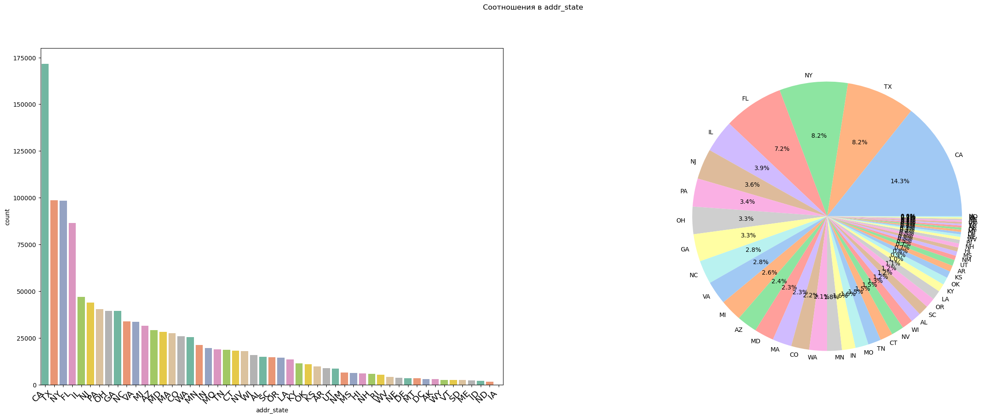

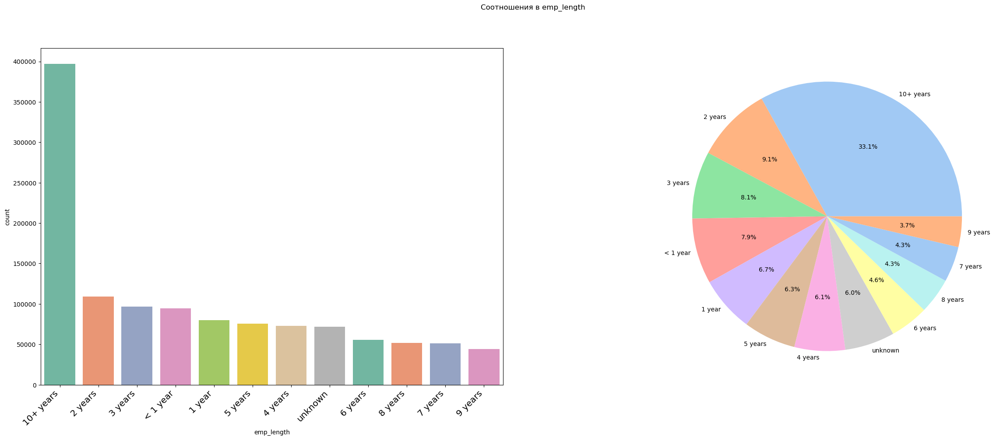

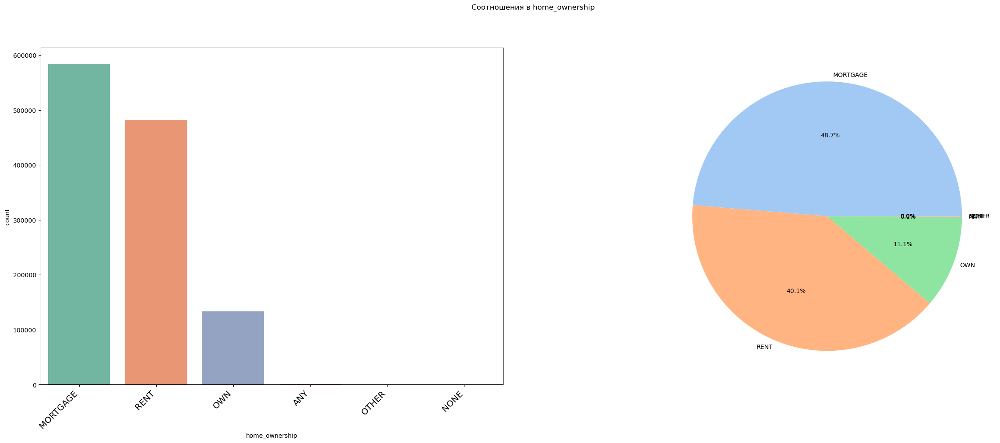

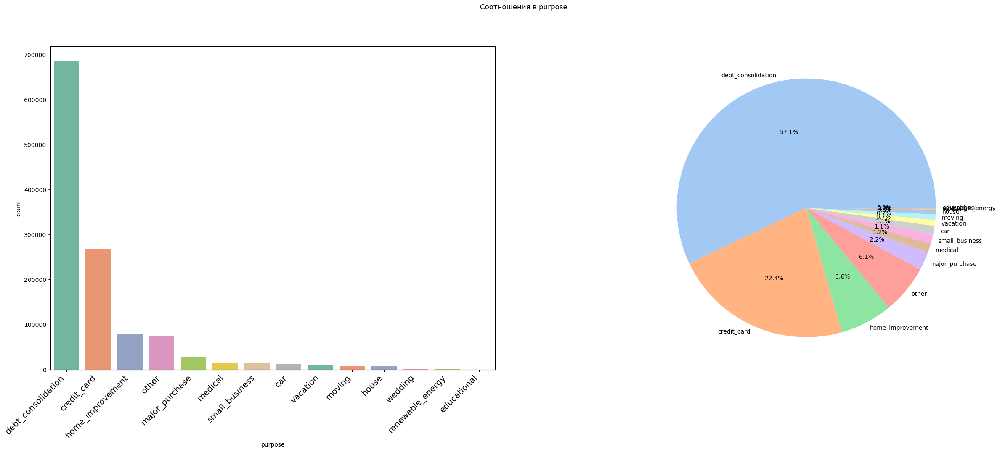

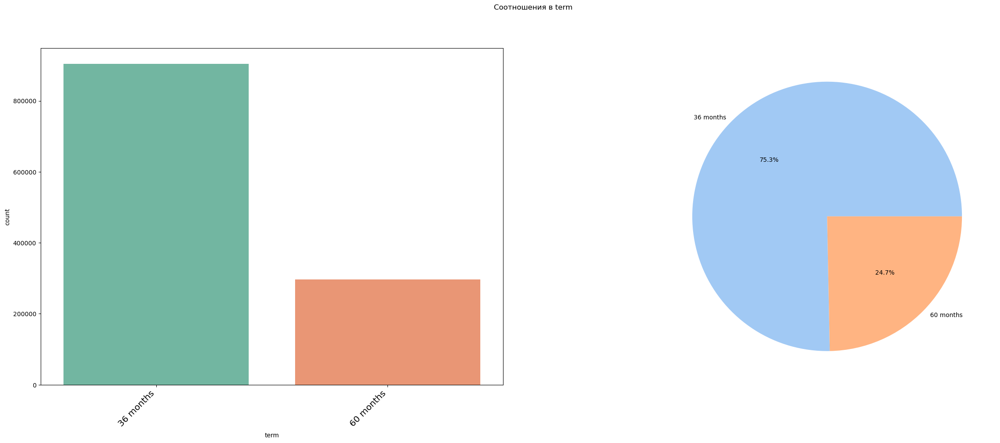

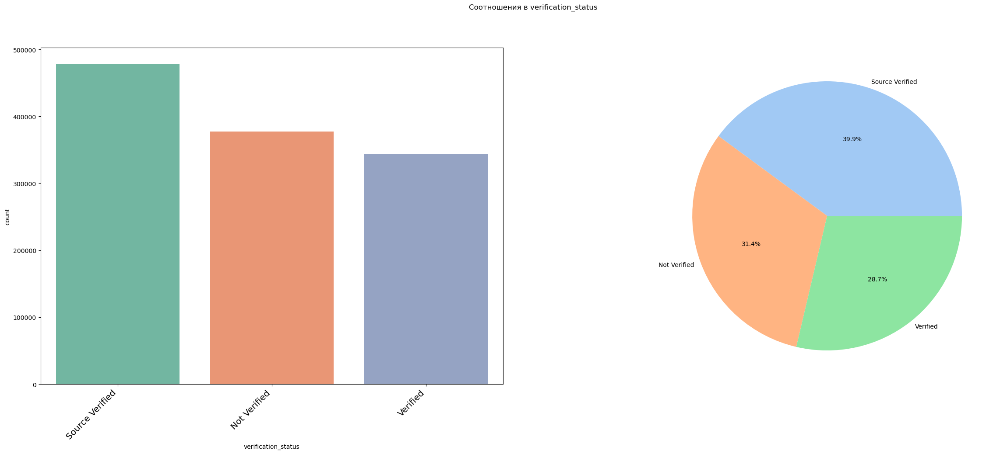

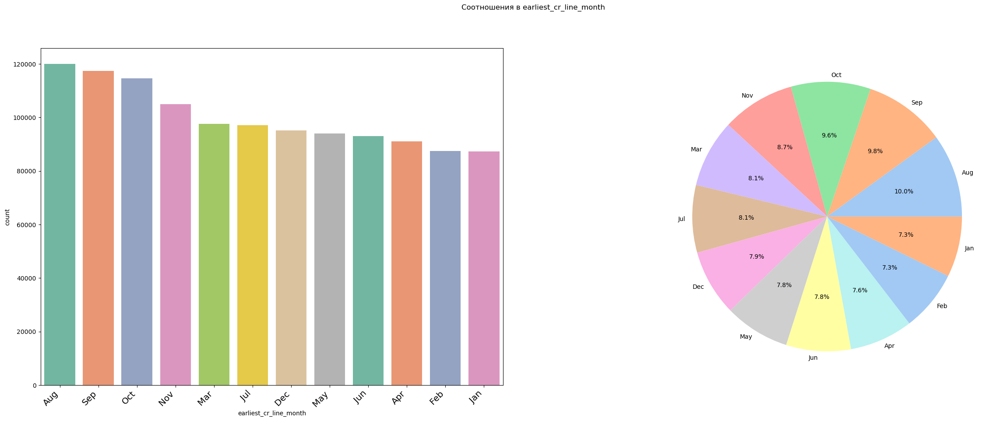

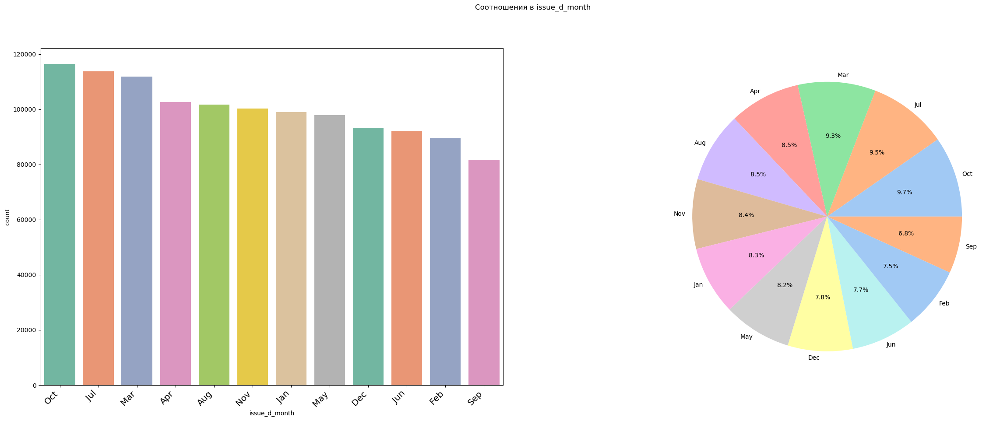

In [25]:
for c in categorial:
    cat_plot(c,train_features)

1) У меня есть серьёзные сомнения, которые касаются признака addr_state, так как в нём довольно много категорий (а именно 51). И мне кажется, что этот признак довольно уверенно заменяется почтовым индексом, так как он и указывает на штат. Поэтому имеет смысл убрать его из рассмотрения. Как минимум его не нужно будет кодировать :)
2) Признак emp_length не шибко разнообразный (около 33% всей обучающей выборки составляют субъекты со стажем более 10 лет), но его легко закодировать, так как он уже проранжирован. Останется только замэпить. Но временная категория "unknown" оказалась не самой маленькой (6%). Как её закодировать? Модой или отдельной категорией? Пожалуй, будем считать, что неизвестные - безработные, поэтому у них значение -1.
3) Признак home_ownership. Там присутствует 3 основные категории: Ипотека, аренда, собственное. Остальные категории очень малы по сравнению с этой. На мой взгляд имеет смысл объединить их в одну категорию "Другое"
4) Признак purpose, то есть цель кредита. В моём субъективном восприятии этот признак как будто должен быть важен. Но опять же превалирует одна категория - debt_consolidation (погашение долга(ов)), затем идёт кредитная карта и т.д. Мне кажется, что есть возможность объединить данные категории следующим образом: Финансовые (credit_card, debt_consolidation), Личные (car, major_purchase, small_business, home_improvement, moving, medical, wedding, vacation, house, renewable_energy, educational). Однако можно попробовать ничего не объединять и просто закодировать ТаргетИнгодером... :)
5) Признак term. 36 месяцев превалирует. Закодировать легко, оставить только числа 36 и 60.
6) Признак verification_status. Если честно, не очень понимаю различия между Verified и Source Verified. Но допустим, что их можно проранжировать следующим образом: Not Verified = 0, Verified = 1, Source Verified = 2
7) Признак earliest_cr_line (Месяц открытия самой ранней из заявленных кредитных карт заемщика) как будто обладает приблизительно равномерной структурой (доля колеблется от 7 до 10% для каждой категории). И как будто бы месяцы легко закодировать (январь = 1, а декабрь = 12). Но ведь январь очень близко с декабрём. Опять же можно использовать ТаргетИнгодер.
8) Признак issue_d (Месяц, когда кредит был предоставлен). Аналогично предыдущему признаку, только порядок месяцев разный. И чуйка мне подсказывает, что этот признак важен

В категориальных признаках ситуация примерно такая же, различается только порядок месяцев в последних двух признаках.

In [26]:
def hist_cat_plot(feature, data):
    plt.suptitle(f'Гистограмма {feature} по отношению к результирующему признаку', fontsize=10);
    ax = sns.histplot(x = data[feature], hue=data['loan_status'], multiple="dodge", palette="husl", alpha = 1,
                  stat = 'density', shrink = 0.8, common_norm=False)
    plt.setp(ax.get_xticklabels(), rotation=90)
    plt.show()

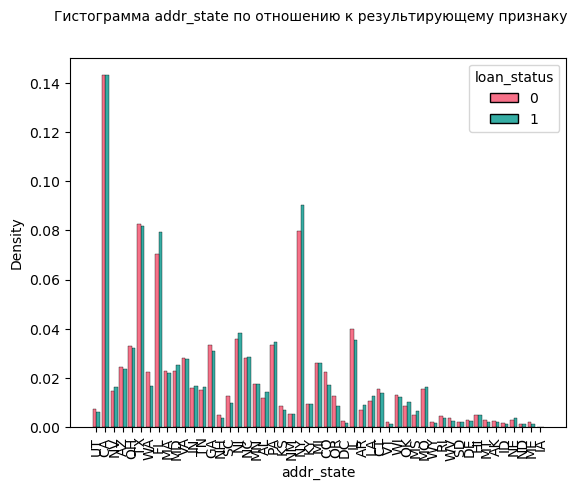

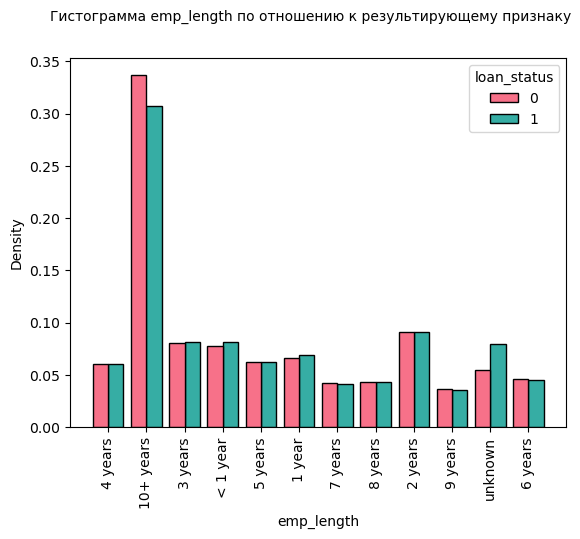

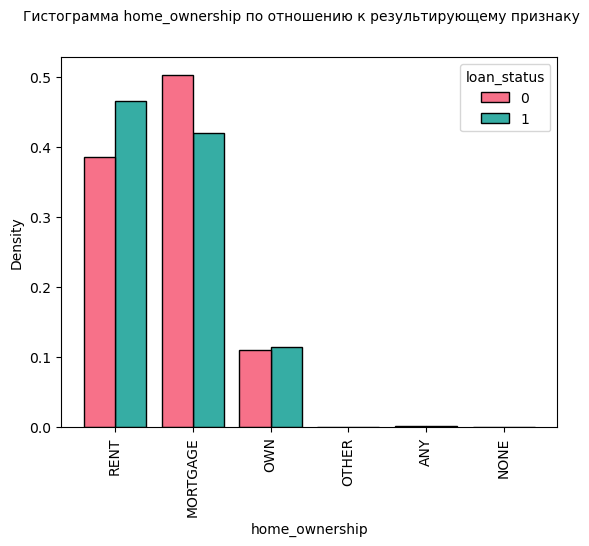

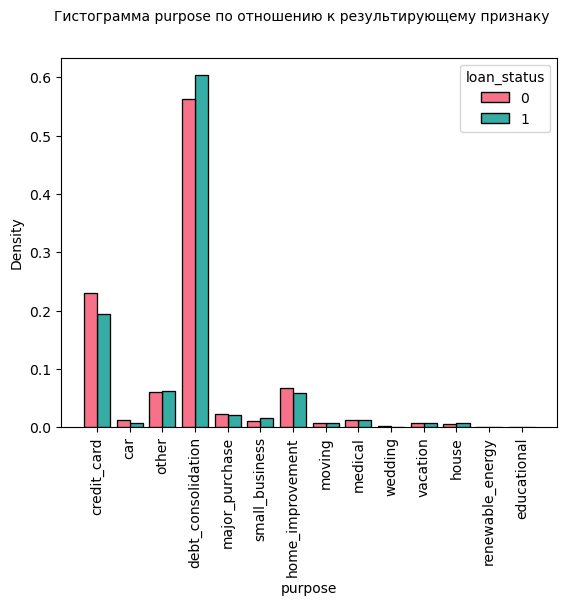

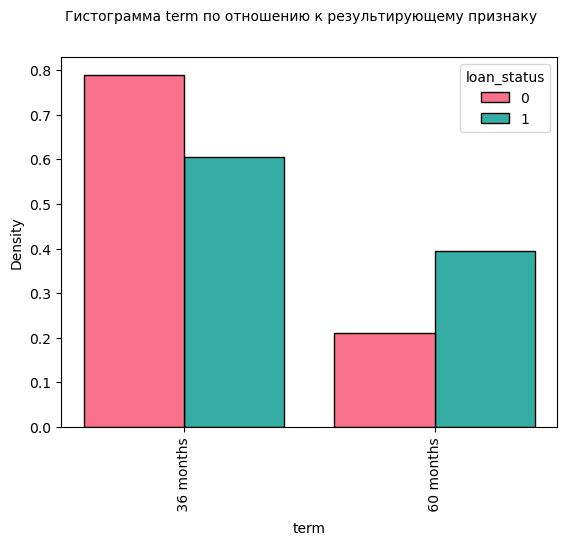

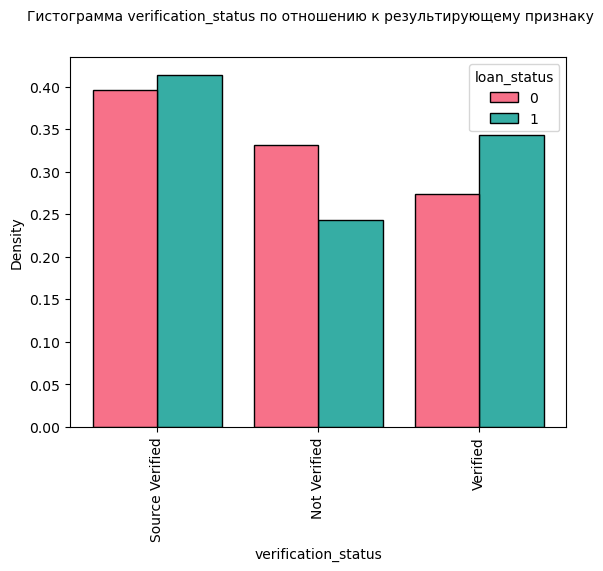

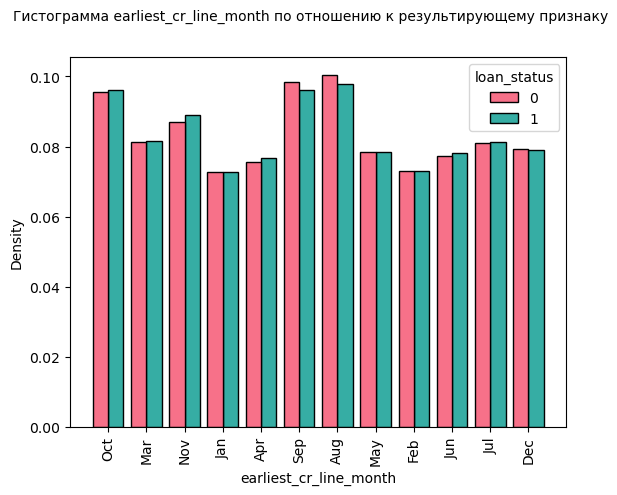

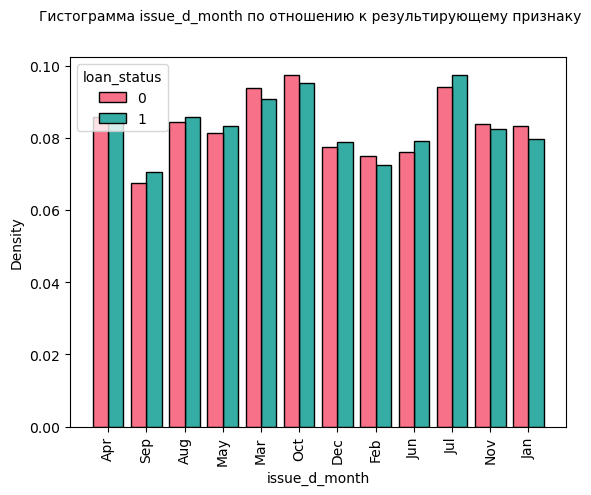

In [27]:
for c in categorial:
    hist_cat_plot(c,train_features)

В признаках emp_length, earliest_cr_line и issue_d соотношение классов примерно сбалансировано.

In [28]:
fig = px.histogram(train_features, x="loan_status")
fig.show()

Классы очевидно не сбалансированы. Дефолтных почти в 5 раз меньше.

#### 2.2 Визуализация числовых признаков

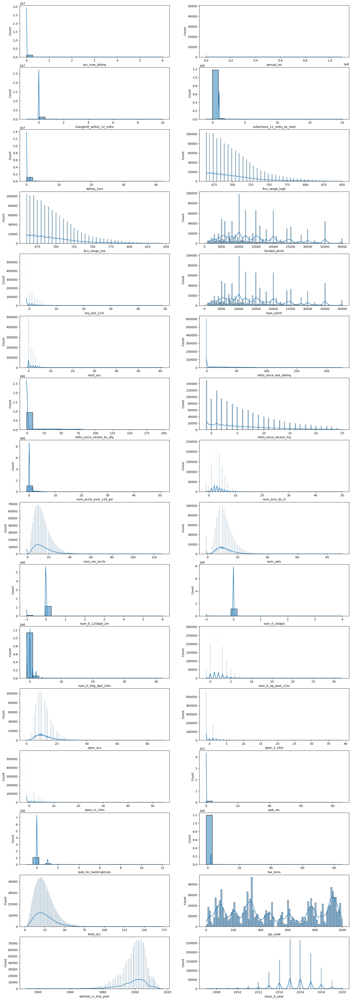

In [29]:
f, ax = plt.subplots(16, 2, figsize=(20, 60))
for i, c in enumerate(numerical_discr):
    sns.histplot(train_features[c], kde=True, ax=ax[i//2, i%2])

Для дискретных конечно картина не самая благополучная, так как явно нормальным распределением тут и не пахнет.

1) Для признака acc_now_delinq заметно, что чаще всего заёмщики не имеют просроченных счетов
2) chargeoff_within_12_mths (количество списаний за 12 м) варьируется от 0 до 10 (не считая пропуски в -1). Больше 0
3) collections_12_mths_ex_med (списания кроме мед показаний). Ещё больше 0
4) delinq_2yrs. Количество просрочек тоже ближе к 0
5) fico_range_high располагается довольно очевидно, чем больше сумма, тем меньше заёмщиков к ней относятся. Аналогично fico_range_low
6) funded_amnt (сумма обязательств) выглядит интересненько. Чаще всего выдают "красивые" суммы, то есть целые (5 000, 10 000 и т.д.). Чаще всего выдают 10 000
7) inq_last_12m (количество кредитных запросов за 12 месяцев) от 0 почти до 50. Осносная часть до 10
8) loan_amnt (заявленная сумма кредита) выглядит ну очень похожей с funded_amnt. Есть смысл сделать новый признак (разница между этими двумя)
9) mort_acc (количество ипотечных счетов) от 0 до 60 с лишним. Длинный хвост справа
10) mths_since_last_delinq (количество месяцев с последней просрочки). Большая часть заполнена -1 (пропуски)
11) mths_since_recent_bc_dlq (просрочки по банковской карте). Длинный хвост после 75
12) mths_since_recent_inq (количество месяцев с момента последнего запроса). Практически ровная лесенка
13) num_accts_ever_120_pd (количество счетов, просроченных на 120 и более дней) располагается в основном до 10
14) num_actv_bc_tl (количество активных в настоящее время счетов банковских карт) располагается примерно до 15. Если бы не длинный хвост, было бы уже больше похоже на нормальное распределение
15) num_rev_accts и num_sats по распределению очень похожи друг на друга (есть смысл оставить только num_rev_accts)
16) num_tl_120dpd_2m и num_tl_30dpd также схожи по распределению (я бы предпочла num_tl_120dpd_2m)
17) num_tl_90g_dpd_24m имеет очень длинный хвост справа
18) num_tl_op_past_12m имеет длинный хвост справа, но в целом походит на нормальное
19) open_acc имеет очень длинный хвост справа
20) open_il_24m имеет большую часть пропусков. Есть смысл удалить этот признак. Аналогично open_rv_24m
21) pub_rec чаще всего имеет значение 0, однако были субъекты, у которых значение данного признака более 80
22) pub_rec_bankruptcies варьируется от 0 до 12
23) tax_liens количество налоговых задолженностей. Больше нулей. Однако мне субъективно кажется, что признак может быть полезен
24) total_acc имеет длинный хвост справа.
25) На мой взгляд zip_code имеет схожую картину с addr_state, поэтому они взаимозаменяемые
26) earliest_cr_line. У какого-то субъекта был открыт счет ранее 1940? Круто конечно. Поэтому хвост слева такой длинный.
27) issue_d до 2020 года. Чаще всего выдавали кредиты в 2015-2016 году.

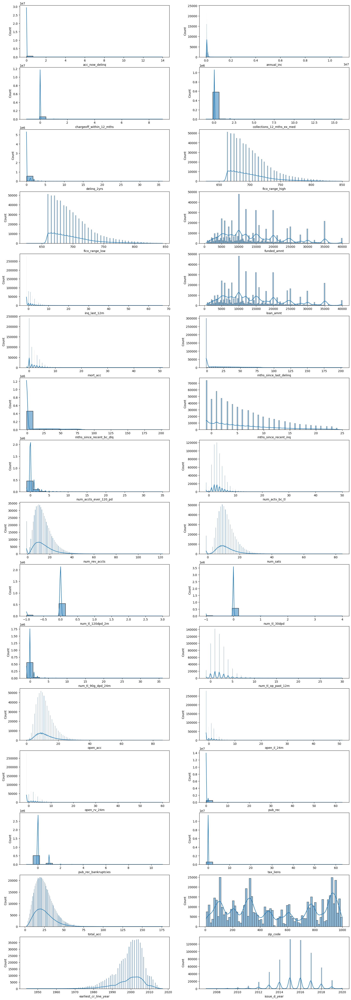

In [30]:
f, ax = plt.subplots(16, 2, figsize=(20, 60))
for i, c in enumerate(numerical_discr):
    sns.histplot(test_features[c], kde=True, ax=ax[i//2, i%2])

В тестовой выброке наблюдаются очень похожие распределения. В теории можно попробовать преобразование Бокса-Кокса.

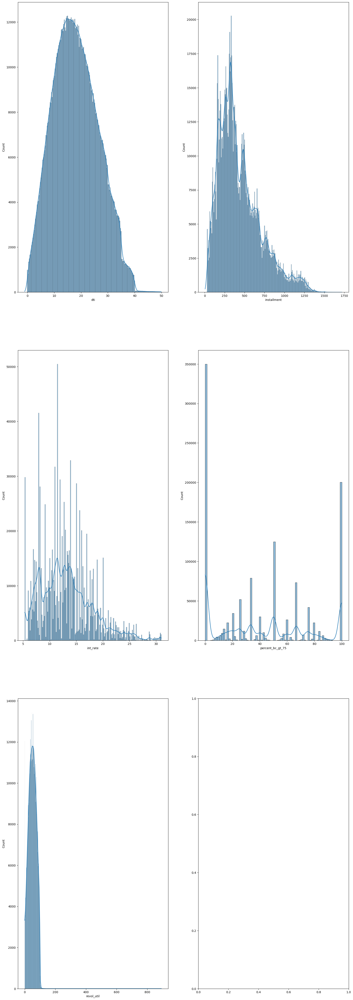

In [31]:
f, ax = plt.subplots(3, 2, figsize=(20, 60))
for i, c in enumerate(numerical_cont):
    sns.histplot(train_features[c], kde=True, ax=ax[i//2, i%2])

С непрерывными величинами конечно картина поприятнее.
1) dti даже почти красиво рапределён. Однако данный признак - преобразование нескольких других
2) installment (ежемесячный платёж) имеет хвост справа
3) int_rate имеет совсем страшную структуру :)
4) percent_bc_gt_75 (Процент всех счетов банковских карт > 75% от лимита) также имеет несуразное распределение
5) revol_util также посчитанный на основе других признаков показатель. Имеет очень длинный хвост справа

Рассмотрим корреляцию признаков с целевым:

In [32]:
corr = train_features.corr()[['loan_status']].sort_values(['loan_status'], ascending=False)
с1 = corr.style.background_gradient(cmap='RdYlGn')
с1

,loan_status
loan_status,1.000000
int_rate,0.251393
dti,0.088020
num_tl_op_past_12m,0.083183
funded_amnt,0.069562
loan_amnt,0.069539
open_rv_24m,0.066928
installment,0.057312
percent_bc_gt_75,0.056675
inq_last_12m,0.056088


Ну картина как будто бы печальная. Необработанные данные имеют очень низкую корреляцию с результирующим признаком. Нужно пробовать преображать, может что удастся улучшить.

Краткое саммари:
1) Удаляем : addr_state
2) В признаке home_ownership объединяем категории (any, other, none) = ANOTHER
3) Кодируем таргет инкодером: home_ownership, purpose
4) OrdinalEncoder для emp_length(<1 years = 0, ..., >10 years= 20, unknown = -1), earliest_cr_line и issue_d по месяцам от 1 до 12
5) У признака term убираем месяц и оставляем только числа 36 и 60
6) Создать новый признак loan_amnt - funded_amnt. И удалить их

### 3. Построение базлайна

Для построения базлайна больше никаких преобразований с данными не было преведено.

Была использована модель Катбуста с дефолтными параметрами.

Базлайновое решение залетело на 0.4605

Для первой "базовой" модели как будто бы неплохо. Окей.

### 4. Предобработка данных

In [33]:
Month = {'Jan': 1, 'Feb': 2, 'Mar': 3,'Apr': 4, 'May': 5, 'Jun': 6, 'Jul': 7, 'Aug': 8,'Sep': 9, 'Oct': 10, 'Nov': 11, 'Dec': 12}

In [34]:
sort = {'Verified': 0, 'Not Verified': -1, 'Source Verified': 1}

In [35]:
emp = {'10+ years': 11, '9 years': 9, '8 years': 8, '7 years': 7, '6 years': 6, '5 years': 5, '4 years': 4, '3 years': 3, '2 years': 2, '1 year': 1, '< 1 year': 0.5, 'unknown': -1}

В планах:
1) Убрать неинформативные на субъективный взгляд признаки или их преобразровать.
2) Закодировать категориальные признаки на своё усмотрение.
3) Стандартизировать всё.
4) Попробовать провести преобразование Бокса-Кокса (Спойлер:  :))

In [36]:
full_df.drop(columns = ['addr_state' ],axis = 1, inplace=True)

In [37]:
full_df['home_ownership'] = full_df['home_ownership'].replace(['ANY', 'OTHER', 'NONE'], ['ANOTHER', 'ANOTHER','ANOTHER'])

In [38]:
full_df[['term_m','term_oth']] = full_df['term'].str.split('m', 1 , expand= True )
full_df['term_m'] = full_df['term_m'].astype (int)
full_df.drop(columns = ['term','term_oth'],axis = 1, inplace=True)

In [39]:
full_df['amnt'] = full_df['loan_amnt'] - full_df['funded_amnt']
full_df.drop(columns = ['loan_amnt','funded_amnt'],axis = 1, inplace=True)

In [40]:
pipe_steps = [
    ('encoder', TargetEncoder()),
    ('scaler', StandardScaler())
]

pipe = Pipeline(steps=pipe_steps)

In [41]:
pipe_steps1 = [
    ('cat_feat_1', OrdinalEncoder(mapping=[{'col': 'emp_length', 'mapping': emp},
                                                 {'col': 'earliest_cr_line_month', 'mapping': Month},
                                                {'col': 'issue_d_month', 'mapping': Month},
                                                {'col': 'verification_status', 'mapping': sort}])),
    ('scaler', StandardScaler())
]

pipe1 = Pipeline(steps=pipe_steps1)

In [42]:
numerical_discr = [f for f in full_df.columns if (full_df.dtypes[f] == 'int64' or full_df.dtypes[f] == 'int32') and f != 'loan_status']
numerical_cont = [f for f in full_df.columns if full_df.dtypes[f] == 'float64']
numerical = numerical_cont + numerical_discr

In [43]:
transformer = ColumnTransformer(
    [('category', Pipeline(steps=pipe_steps), ['home_ownership','purpose']),
    ('category2', Pipeline(steps=pipe_steps1), ['emp_length', 'earliest_cr_line_month', 'issue_d_month','verification_status']),
    ('standart', StandardScaler(), numerical)]
)

In [44]:
train_features = full_df.iloc[:idx_split].copy()
train_features.index = df_train.index
train_features['loan_status'] = y_train
train_features

,acc_now_delinq,annual_inc,chargeoff_within_12_mths,collections_12_mths_ex_med,delinq_2yrs,dti,emp_length,fico_range_high,fico_range_low,home_ownership,...,total_acc,verification_status,zip_code,earliest_cr_line_month,earliest_cr_line_year,issue_d_month,issue_d_year,term_m,amnt,loan_status
index,,,,,,,,,,,,,,,,,,,,,
0,0,80000,0,0,0,30.49,4 years,689,685,RENT,...,26,Source Verified,847,Oct,1996,Apr,2016,36,0,1
1,0,82000,0,0,0,7.00,10+ years,689,685,MORTGAGE,...,11,Not Verified,900,Mar,1993,Sep,2017,36,0,0
2,0,46080,0,0,1,17.32,3 years,674,670,MORTGAGE,...,31,Source Verified,895,Nov,2000,Aug,2016,36,0,1
3,0,30000,0,0,0,7.80,< 1 year,694,690,OWN,...,24,Source Verified,853,Jan,2010,Aug,2015,36,0,0
4,0,70000,0,0,0,13.36,< 1 year,674,670,RENT,...,16,Not Verified,453,Jan,2002,Sep,2017,60,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1199856,0,41000,0,0,0,22.97,4 years,684,680,RENT,...,8,Source Verified,604,Feb,2002,Jun,2012,36,0,0
1199857,0,95000,0,0,0,25.63,3 years,709,705,RENT,...,29,Verified,106,Jan,2002,Nov,2013,36,0,0
1199858,0,61000,0,0,0,15.58,8 years,774,770,OWN,...,26,Source Verified,21,Nov,2002,Dec,2015,60,0,0


In [45]:
test_features = full_df.iloc[idx_split:].copy()
test_features.index = df_test.index
test_features

,acc_now_delinq,annual_inc,chargeoff_within_12_mths,collections_12_mths_ex_med,delinq_2yrs,dti,emp_length,fico_range_high,fico_range_low,home_ownership,...,tax_liens,total_acc,verification_status,zip_code,earliest_cr_line_month,earliest_cr_line_year,issue_d_month,issue_d_year,term_m,amnt
index,,,,,,,,,,,,,,,,,,,,,
0,0,46209,0,0,0,34.98,8 years,669,665,MORTGAGE,...,0,20,Verified,302,Apr,2009,Jan,2016,60,0
1,0,43500,0,0,0,20.25,5 years,704,700,OWN,...,0,32,Not Verified,151,Jun,1982,Apr,2011,60,0
2,0,72000,0,0,0,15.98,3 years,699,695,MORTGAGE,...,0,36,Verified,440,Nov,1997,Nov,2012,36,0
3,0,120000,0,0,0,24.93,10+ years,784,780,MORTGAGE,...,0,31,Not Verified,710,Jul,2001,Jun,2017,36,0
4,0,55000,0,0,1,23.22,10+ years,689,685,MORTGAGE,...,0,28,Not Verified,465,Sep,1990,Sep,2016,36,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
590972,0,39000,0,0,1,26.77,3 years,694,690,RENT,...,0,20,Source Verified,916,Oct,2007,Aug,2015,36,0
590973,0,80000,0,0,1,22.54,10+ years,674,670,MORTGAGE,...,0,37,Verified,601,Nov,1991,Jul,2015,36,0
590974,0,42000,0,0,0,21.60,10+ years,709,705,MORTGAGE,...,0,22,Source Verified,431,Feb,1976,Apr,2015,60,0


In [46]:
transformer.fit(train_features, train_features['loan_status'])

ColumnTransformer(transformers=[('category',
                                 Pipeline(steps=[('encoder', TargetEncoder()),
                                                 ('scaler', StandardScaler())]),
                                 ['home_ownership', 'purpose']),
                                ('category2',
                                 Pipeline(steps=[('cat_feat_1',
                                                  OrdinalEncoder(mapping=[{'col': 'emp_length',
                                                                           'data_type': dtype('O'),
                                                                           'mapping': 10+ years    11.0
9 years       9.0
8 years       8.0
7 years       7.0
6 years       6.0
5 years       5.0
4 years       4.0
3 years       3.0
2 years       2...
                                  'fico_range_high', 'fico_range_low',
                                  'inq_last_12m', 'mort_acc',
                                  'mths_si

In [47]:
X_train, X_test, y_train, y_test = train_test_split(
    train_features.drop('loan_status', axis=1), train_features['loan_status'],
    test_size=0.3,
    stratify=train_features['loan_status'],
    random_state=22)

In [48]:
X_train = transformer.fit_transform(X_train, y_train)

In [49]:
X_test = transformer.transform(X_test)

In [50]:
df_test = transformer.transform(test_features)

In [51]:
pt = PowerTransformer()

In [52]:
pt.fit(X_train)

PowerTransformer()

In [53]:
X_train_Box = pt.transform(X_train)

In [54]:
X_test_Box= pt.transform(X_test)

In [55]:
df_test_Box = pt.transform(df_test)

### 5. Попытки улучшения

Из планируемых действий:
1) Понастраивать Логистическую регрессию
2) Понастраивать Катбуст
3) Понастраивать lgbm
4) Понастраивать xgboost
5) Выбрать лучшее и предсказать

#### 5.2 Логистическая регрессия:

In [41]:
lr = LogisticRegression().fit(X_train_Box, y_train)

In [44]:
cv = KFold(n_splits=2, shuffle=True, random_state=22)

cv_scores = cross_val_score(lr, X_train_Box, y_train, cv=cv,
                           scoring='roc_auc', n_jobs=-1)

print(cv_scores, cv_scores.mean()*2-1)

[0.71095602 0.70986234] 0.4208183610849541


Ну что-то маловато, зато обучается быстро. Попробую погридсерчить:

In [51]:
param_grid ={'C': np.arange(0, 1, 0.1),
             'penalty' : ['l1', 'l2'],
            'max_iter': np.arange(100,500,100),
            'class_weight':['None','balanced'],
            'solver' : ['lbfgs', 'saga'],
            'verbose': np.arange(0, 0.1, 0.1)}

grid_logit = GridSearchCV(lr, param_grid, cv=cv, scoring='roc_auc',
                          n_jobs=-1, verbose=True) 
grid_logit.fit(X_train_Box, y_train)

Fitting 2 folds for each of 320 candidates, totalling 640 fits


C:\Users\pletneva\.conda\envs\msa\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
192 fits failed out of a total of 640.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
160 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\pletneva\.conda\envs\msa\lib\site-packages\sklearn\model_selection\_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\pletneva\.conda\envs\msa\lib\site-packages\sklearn\linear_model\_logistic.py", line 1461, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "C:\Users\pletneva\.conda\envs\msa\lib\site-packages\sklearn\linear_model\_logistic.py", line 449, in _

GridSearchCV(cv=KFold(n_splits=2, random_state=22, shuffle=True),
             estimator=LogisticRegression(), n_jobs=-1,
             param_grid={'C': array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]),
                         'class_weight': ['None', 'balanced'],
                         'max_iter': array([100, 200, 300, 400]),
                         'penalty': ['l1', 'l2'], 'solver': ['lbfgs', 'saga'],
                         'verbose': array([0.])},
             scoring='roc_auc', verbose=True)

Зафейлилось, потому что некоторые параметры в сочетании не могут быть реализованы, ну да ладно. Смотрим лучшие параметры и скор:

In [52]:
print(grid_logit.best_params_, grid_logit.best_score_)

{'C': 0.1, 'class_weight': 'balanced', 'max_iter': 300, 'penalty': 'l1', 'solver': 'saga', 'verbose': 0.0} 0.7104105222534953


In [53]:
 grid_logit.best_score_*2-1

0.42082104450699065

Ну всё равно хуже, чем базлайн, поэтому хочу попробовать другие модели:

#### 5.2 XGBClassifier:

In [74]:
xgbc=XGBClassifier().fit(X_train_Box, y_train)

In [75]:
cv = KFold(n_splits=2, shuffle=True, random_state=22)
cv_scores = cross_val_score(xgbc, X_train_Box, y_train, cv=cv,
                           scoring='roc_auc', n_jobs=-1)

print(cv_scores, cv_scores.mean())
print(cv_scores*2 - 1, cv_scores.mean()*2 - 1)

[0.72233238 0.72159705] 0.721964713797293
[0.44466476 0.4431941 ] 0.443929427594586


Уже выше, чем логистическая регрессия. Попробую погридсерчить:

In [65]:
param_grid ={'max_depth':np.arange(3, 6, 1),
 'min_child_weight':np.arange(3, 6, 1),
            'n_estimators': np.arange(200, 400, 50),
            'learning_rate': np.arange(0.1, 0.5, 0.1)}

grid_xgbc = GridSearchCV(xgbc, param_grid, cv=cv, scoring='roc_auc',
                          n_jobs=-1, verbose=True) 
grid_xgbc.fit(X_train_Box, y_train)

Fitting 2 folds for each of 144 candidates, totalling 288 fits


GridSearchCV(cv=KFold(n_splits=2, random_state=22, shuffle=True),
             estimator=XGBClassifier(base_score=0.5, booster='gbtree',
                                     callbacks=None, colsample_bylevel=1,
                                     colsample_bynode=1, colsample_bytree=1,
                                     early_stopping_rounds=None,
                                     enable_categorical=False, eval_metric=None,
                                     gamma=0, gpu_id=-1,
                                     grow_policy='depthwise',
                                     importance_type=None,
                                     interaction_constraints=''...
                                     min_child_weight=1, missing=nan,
                                     monotone_constraints='()',
                                     n_estimators=100, n_jobs=0,
                                     num_parallel_tree=1, predictor='auto',
                                     random_st

In [66]:
print(grid_xgbc.best_params_, grid_xgbc.best_score_*2 -1)

{'learning_rate': 0.1, 'max_depth': 5, 'min_child_weight': 4, 'n_estimators': 350} 0.450923845486052


In [67]:
xgbc_opt = XGBClassifier(random_state=22, **grid_xgbc.best_params_).fit(X_train_Box, y_train)

In [68]:
xgbc_pred_proba = xgbc_opt.predict_proba(X_test_Box)

In [69]:
roc_auc = roc_auc_score(y_test, xgbc_pred_proba[:, 1])
print('Рок-Аук:', roc_auc, '\n','Джинни:', roc_auc*2 - 1)

Рок-Аук: 0.7274574448820306 
 Джинни: 0.45491488976406114


Ну неплохо. Подбор параметров помог, однако при загрузке на сайт это не оказалось лучшим решением. Ищу дальше.

#### 5.3 CatBoostClassifier

In [56]:
cbc=CatBoostClassifier().fit(X_train_Box, y_train)

Learning rate set to 0.182633
0:	learn: 0.6058092	total: 332ms	remaining: 5m 32s
1:	learn: 0.5490599	total: 509ms	remaining: 4m 13s
2:	learn: 0.5136740	total: 678ms	remaining: 3m 45s
3:	learn: 0.4907371	total: 843ms	remaining: 3m 29s
4:	learn: 0.4772648	total: 1s	remaining: 3m 19s
5:	learn: 0.4680875	total: 1.17s	remaining: 3m 13s
6:	learn: 0.4614152	total: 1.35s	remaining: 3m 11s
7:	learn: 0.4575203	total: 1.51s	remaining: 3m 7s
8:	learn: 0.4541323	total: 1.68s	remaining: 3m 4s
9:	learn: 0.4518892	total: 1.85s	remaining: 3m 3s
10:	learn: 0.4503471	total: 2.03s	remaining: 3m 2s
11:	learn: 0.4491205	total: 2.22s	remaining: 3m 2s
12:	learn: 0.4480105	total: 2.4s	remaining: 3m 2s
13:	learn: 0.4470808	total: 2.58s	remaining: 3m 1s
14:	learn: 0.4464003	total: 2.76s	remaining: 3m 1s
15:	learn: 0.4459555	total: 2.93s	remaining: 3m
16:	learn: 0.4455115	total: 3.12s	remaining: 3m
17:	learn: 0.4450940	total: 3.28s	remaining: 2m 59s
18:	learn: 0.4447225	total: 3.48s	remaining: 2m 59s
19:	learn: 0

158:	learn: 0.4351673	total: 27.9s	remaining: 2m 27s
159:	learn: 0.4351219	total: 28.1s	remaining: 2m 27s
160:	learn: 0.4350871	total: 28.3s	remaining: 2m 27s
161:	learn: 0.4350578	total: 28.4s	remaining: 2m 27s
162:	learn: 0.4350242	total: 28.6s	remaining: 2m 27s
163:	learn: 0.4349898	total: 28.8s	remaining: 2m 26s
164:	learn: 0.4349479	total: 29s	remaining: 2m 26s
165:	learn: 0.4349042	total: 29.2s	remaining: 2m 26s
166:	learn: 0.4348767	total: 29.3s	remaining: 2m 26s
167:	learn: 0.4348347	total: 29.5s	remaining: 2m 26s
168:	learn: 0.4348085	total: 29.7s	remaining: 2m 25s
169:	learn: 0.4347699	total: 29.9s	remaining: 2m 25s
170:	learn: 0.4347369	total: 30s	remaining: 2m 25s
171:	learn: 0.4347028	total: 30.2s	remaining: 2m 25s
172:	learn: 0.4346638	total: 30.4s	remaining: 2m 25s
173:	learn: 0.4346338	total: 30.6s	remaining: 2m 25s
174:	learn: 0.4346012	total: 30.8s	remaining: 2m 25s
175:	learn: 0.4345588	total: 31s	remaining: 2m 25s
176:	learn: 0.4345302	total: 31.2s	remaining: 2m 24s

315:	learn: 0.4310224	total: 57s	remaining: 2m 3s
316:	learn: 0.4309983	total: 57.2s	remaining: 2m 3s
317:	learn: 0.4309712	total: 57.4s	remaining: 2m 3s
318:	learn: 0.4309617	total: 57.5s	remaining: 2m 2s
319:	learn: 0.4309409	total: 57.7s	remaining: 2m 2s
320:	learn: 0.4309153	total: 57.9s	remaining: 2m 2s
321:	learn: 0.4308896	total: 58.1s	remaining: 2m 2s
322:	learn: 0.4308681	total: 58.2s	remaining: 2m 2s
323:	learn: 0.4308504	total: 58.4s	remaining: 2m 1s
324:	learn: 0.4308335	total: 58.6s	remaining: 2m 1s
325:	learn: 0.4308051	total: 58.8s	remaining: 2m 1s
326:	learn: 0.4307831	total: 58.9s	remaining: 2m 1s
327:	learn: 0.4307509	total: 59.1s	remaining: 2m 1s
328:	learn: 0.4307262	total: 59.3s	remaining: 2m
329:	learn: 0.4307036	total: 59.5s	remaining: 2m
330:	learn: 0.4306729	total: 59.6s	remaining: 2m
331:	learn: 0.4306555	total: 59.8s	remaining: 2m
332:	learn: 0.4306380	total: 60s	remaining: 2m
333:	learn: 0.4306120	total: 1m	remaining: 2m
334:	learn: 0.4305807	total: 1m	remai

470:	learn: 0.4277947	total: 1m 25s	remaining: 1m 35s
471:	learn: 0.4277776	total: 1m 25s	remaining: 1m 35s
472:	learn: 0.4277579	total: 1m 25s	remaining: 1m 35s
473:	learn: 0.4277440	total: 1m 25s	remaining: 1m 35s
474:	learn: 0.4277253	total: 1m 26s	remaining: 1m 35s
475:	learn: 0.4276995	total: 1m 26s	remaining: 1m 34s
476:	learn: 0.4276849	total: 1m 26s	remaining: 1m 34s
477:	learn: 0.4276655	total: 1m 26s	remaining: 1m 34s
478:	learn: 0.4276415	total: 1m 26s	remaining: 1m 34s
479:	learn: 0.4276208	total: 1m 26s	remaining: 1m 34s
480:	learn: 0.4276044	total: 1m 27s	remaining: 1m 34s
481:	learn: 0.4275914	total: 1m 27s	remaining: 1m 33s
482:	learn: 0.4275703	total: 1m 27s	remaining: 1m 33s
483:	learn: 0.4275382	total: 1m 27s	remaining: 1m 33s
484:	learn: 0.4275182	total: 1m 27s	remaining: 1m 33s
485:	learn: 0.4275004	total: 1m 28s	remaining: 1m 33s
486:	learn: 0.4274756	total: 1m 28s	remaining: 1m 33s
487:	learn: 0.4274642	total: 1m 28s	remaining: 1m 32s
488:	learn: 0.4274481	total:

622:	learn: 0.4250256	total: 1m 52s	remaining: 1m 8s
623:	learn: 0.4250081	total: 1m 52s	remaining: 1m 8s
624:	learn: 0.4249909	total: 1m 53s	remaining: 1m 7s
625:	learn: 0.4249736	total: 1m 53s	remaining: 1m 7s
626:	learn: 0.4249609	total: 1m 53s	remaining: 1m 7s
627:	learn: 0.4249373	total: 1m 53s	remaining: 1m 7s
628:	learn: 0.4249240	total: 1m 53s	remaining: 1m 7s
629:	learn: 0.4249079	total: 1m 54s	remaining: 1m 7s
630:	learn: 0.4248959	total: 1m 54s	remaining: 1m 6s
631:	learn: 0.4248816	total: 1m 54s	remaining: 1m 6s
632:	learn: 0.4248597	total: 1m 54s	remaining: 1m 6s
633:	learn: 0.4248460	total: 1m 55s	remaining: 1m 6s
634:	learn: 0.4248349	total: 1m 55s	remaining: 1m 6s
635:	learn: 0.4248126	total: 1m 55s	remaining: 1m 6s
636:	learn: 0.4247879	total: 1m 55s	remaining: 1m 5s
637:	learn: 0.4247704	total: 1m 55s	remaining: 1m 5s
638:	learn: 0.4247534	total: 1m 56s	remaining: 1m 5s
639:	learn: 0.4247349	total: 1m 56s	remaining: 1m 5s
640:	learn: 0.4247196	total: 1m 56s	remaining:

780:	learn: 0.4224810	total: 2m 22s	remaining: 40s
781:	learn: 0.4224590	total: 2m 22s	remaining: 39.8s
782:	learn: 0.4224366	total: 2m 23s	remaining: 39.7s
783:	learn: 0.4224232	total: 2m 23s	remaining: 39.5s
784:	learn: 0.4224070	total: 2m 23s	remaining: 39.3s
785:	learn: 0.4223941	total: 2m 23s	remaining: 39.1s
786:	learn: 0.4223785	total: 2m 23s	remaining: 38.9s
787:	learn: 0.4223638	total: 2m 23s	remaining: 38.7s
788:	learn: 0.4223483	total: 2m 24s	remaining: 38.5s
789:	learn: 0.4223308	total: 2m 24s	remaining: 38.4s
790:	learn: 0.4223136	total: 2m 24s	remaining: 38.2s
791:	learn: 0.4222908	total: 2m 24s	remaining: 38s
792:	learn: 0.4222682	total: 2m 24s	remaining: 37.8s
793:	learn: 0.4222538	total: 2m 25s	remaining: 37.6s
794:	learn: 0.4222303	total: 2m 25s	remaining: 37.4s
795:	learn: 0.4222167	total: 2m 25s	remaining: 37.3s
796:	learn: 0.4222004	total: 2m 25s	remaining: 37.1s
797:	learn: 0.4221854	total: 2m 25s	remaining: 36.9s
798:	learn: 0.4221702	total: 2m 25s	remaining: 36.

937:	learn: 0.4200052	total: 2m 53s	remaining: 11.5s
938:	learn: 0.4199888	total: 2m 53s	remaining: 11.3s
939:	learn: 0.4199709	total: 2m 53s	remaining: 11.1s
940:	learn: 0.4199579	total: 2m 53s	remaining: 10.9s
941:	learn: 0.4199417	total: 2m 54s	remaining: 10.7s
942:	learn: 0.4199269	total: 2m 54s	remaining: 10.5s
943:	learn: 0.4199063	total: 2m 54s	remaining: 10.3s
944:	learn: 0.4198870	total: 2m 54s	remaining: 10.2s
945:	learn: 0.4198633	total: 2m 54s	remaining: 9.98s
946:	learn: 0.4198449	total: 2m 54s	remaining: 9.79s
947:	learn: 0.4198332	total: 2m 55s	remaining: 9.61s
948:	learn: 0.4198114	total: 2m 55s	remaining: 9.42s
949:	learn: 0.4198014	total: 2m 55s	remaining: 9.23s
950:	learn: 0.4197931	total: 2m 55s	remaining: 9.05s
951:	learn: 0.4197754	total: 2m 55s	remaining: 8.86s
952:	learn: 0.4197564	total: 2m 55s	remaining: 8.68s
953:	learn: 0.4197483	total: 2m 56s	remaining: 8.49s
954:	learn: 0.4197348	total: 2m 56s	remaining: 8.31s
955:	learn: 0.4197216	total: 2m 56s	remaining:

На что я могу в первую очередь обратить внимание. С обработанными признаками модели работают почти в 5-6 раз быстрее. Хотя разница в скорах небольшая.

In [58]:
cv = KFold(n_splits=2, shuffle=True, random_state=22)
cv_scores = cross_val_score(cbc, X_train_Box, y_train, cv=cv,
                           scoring='roc_auc', n_jobs=-1)

print(cv_scores, cv_scores.mean())
print(cv_scores*2 - 1, cv_scores.mean()*2 - 1)

[0.72657956 0.72578996] 0.726184763556108
[0.45315913 0.45157992] 0.4523695271122159


In [81]:
param_grid ={'iterations':np.arange(800, 1000, 100),
    'learning_rate': np.arange(0.03, 0.05, 0.01),
    'depth':np.arange(5, 7, 1)}

grid_cbc = GridSearchCV(cbc, param_grid, cv=cv, scoring='roc_auc',
                          n_jobs=-1, verbose=True) 
grid_cbc.fit(X_train_Box, y_train)

Fitting 2 folds for each of 12 candidates, totalling 24 fits
0:	learn: 0.6668293	total: 248ms	remaining: 3m 42s
1:	learn: 0.6436421	total: 474ms	remaining: 3m 32s
2:	learn: 0.6227779	total: 686ms	remaining: 3m 25s
3:	learn: 0.6040558	total: 905ms	remaining: 3m 22s
4:	learn: 0.5872138	total: 1.12s	remaining: 3m 20s
5:	learn: 0.5722017	total: 1.36s	remaining: 3m 22s
6:	learn: 0.5587748	total: 1.58s	remaining: 3m 21s
7:	learn: 0.5476009	total: 1.89s	remaining: 3m 31s
8:	learn: 0.5372522	total: 2.11s	remaining: 3m 29s
9:	learn: 0.5285458	total: 2.31s	remaining: 3m 25s
10:	learn: 0.5205800	total: 2.52s	remaining: 3m 23s
11:	learn: 0.5130243	total: 2.74s	remaining: 3m 22s
12:	learn: 0.5063924	total: 2.94s	remaining: 3m 20s
13:	learn: 0.5006946	total: 3.22s	remaining: 3m 23s
14:	learn: 0.4956011	total: 3.45s	remaining: 3m 23s
15:	learn: 0.4907583	total: 3.7s	remaining: 3m 24s
16:	learn: 0.4865817	total: 3.94s	remaining: 3m 24s
17:	learn: 0.4828297	total: 4.15s	remaining: 3m 23s
18:	learn: 0.4

157:	learn: 0.4407003	total: 33.9s	remaining: 2m 39s
158:	learn: 0.4406745	total: 34.1s	remaining: 2m 38s
159:	learn: 0.4406413	total: 34.2s	remaining: 2m 38s
160:	learn: 0.4406209	total: 34.4s	remaining: 2m 38s
161:	learn: 0.4406020	total: 34.7s	remaining: 2m 37s
162:	learn: 0.4405781	total: 34.8s	remaining: 2m 37s
163:	learn: 0.4405524	total: 35s	remaining: 2m 37s
164:	learn: 0.4405299	total: 35.2s	remaining: 2m 36s
165:	learn: 0.4404998	total: 35.4s	remaining: 2m 36s
166:	learn: 0.4404530	total: 35.6s	remaining: 2m 36s
167:	learn: 0.4404297	total: 35.8s	remaining: 2m 35s
168:	learn: 0.4404123	total: 35.9s	remaining: 2m 35s
169:	learn: 0.4403912	total: 36.2s	remaining: 2m 35s
170:	learn: 0.4403736	total: 36.4s	remaining: 2m 35s
171:	learn: 0.4403548	total: 36.6s	remaining: 2m 34s
172:	learn: 0.4403297	total: 36.8s	remaining: 2m 34s
173:	learn: 0.4403006	total: 37s	remaining: 2m 34s
174:	learn: 0.4402725	total: 37.2s	remaining: 2m 33s
175:	learn: 0.4402497	total: 37.3s	remaining: 2m 3

313:	learn: 0.4379445	total: 1m 6s	remaining: 2m 3s
314:	learn: 0.4379299	total: 1m 6s	remaining: 2m 3s
315:	learn: 0.4379135	total: 1m 6s	remaining: 2m 2s
316:	learn: 0.4379017	total: 1m 6s	remaining: 2m 2s
317:	learn: 0.4378806	total: 1m 6s	remaining: 2m 2s
318:	learn: 0.4378655	total: 1m 7s	remaining: 2m 2s
319:	learn: 0.4378501	total: 1m 7s	remaining: 2m 1s
320:	learn: 0.4378313	total: 1m 7s	remaining: 2m 1s
321:	learn: 0.4378190	total: 1m 7s	remaining: 2m 1s
322:	learn: 0.4378037	total: 1m 7s	remaining: 2m 1s
323:	learn: 0.4377856	total: 1m 8s	remaining: 2m 1s
324:	learn: 0.4377659	total: 1m 8s	remaining: 2m
325:	learn: 0.4377463	total: 1m 8s	remaining: 2m
326:	learn: 0.4377362	total: 1m 8s	remaining: 2m
327:	learn: 0.4377209	total: 1m 8s	remaining: 2m
328:	learn: 0.4377116	total: 1m 9s	remaining: 1m 59s
329:	learn: 0.4376993	total: 1m 9s	remaining: 1m 59s
330:	learn: 0.4376840	total: 1m 9s	remaining: 1m 59s
331:	learn: 0.4376685	total: 1m 9s	remaining: 1m 59s
332:	learn: 0.437657

466:	learn: 0.4360105	total: 1m 37s	remaining: 1m 30s
467:	learn: 0.4360014	total: 1m 37s	remaining: 1m 30s
468:	learn: 0.4359918	total: 1m 37s	remaining: 1m 30s
469:	learn: 0.4359786	total: 1m 38s	remaining: 1m 29s
470:	learn: 0.4359665	total: 1m 38s	remaining: 1m 29s
471:	learn: 0.4359594	total: 1m 38s	remaining: 1m 29s
472:	learn: 0.4359491	total: 1m 38s	remaining: 1m 29s
473:	learn: 0.4359358	total: 1m 38s	remaining: 1m 28s
474:	learn: 0.4359254	total: 1m 39s	remaining: 1m 28s
475:	learn: 0.4359146	total: 1m 39s	remaining: 1m 28s
476:	learn: 0.4359045	total: 1m 39s	remaining: 1m 28s
477:	learn: 0.4358957	total: 1m 39s	remaining: 1m 28s
478:	learn: 0.4358840	total: 1m 39s	remaining: 1m 27s
479:	learn: 0.4358704	total: 1m 40s	remaining: 1m 27s
480:	learn: 0.4358598	total: 1m 40s	remaining: 1m 27s
481:	learn: 0.4358514	total: 1m 40s	remaining: 1m 27s
482:	learn: 0.4358423	total: 1m 40s	remaining: 1m 27s
483:	learn: 0.4358309	total: 1m 40s	remaining: 1m 26s
484:	learn: 0.4358206	total:

622:	learn: 0.4345546	total: 2m 8s	remaining: 57.1s
623:	learn: 0.4345459	total: 2m 8s	remaining: 56.9s
624:	learn: 0.4345397	total: 2m 8s	remaining: 56.7s
625:	learn: 0.4345277	total: 2m 8s	remaining: 56.4s
626:	learn: 0.4345223	total: 2m 9s	remaining: 56.2s
627:	learn: 0.4345136	total: 2m 9s	remaining: 56s
628:	learn: 0.4345058	total: 2m 9s	remaining: 55.8s
629:	learn: 0.4344999	total: 2m 9s	remaining: 55.6s
630:	learn: 0.4344942	total: 2m 9s	remaining: 55.4s
631:	learn: 0.4344831	total: 2m 10s	remaining: 55.2s
632:	learn: 0.4344698	total: 2m 10s	remaining: 55s
633:	learn: 0.4344602	total: 2m 10s	remaining: 54.8s
634:	learn: 0.4344515	total: 2m 10s	remaining: 54.5s
635:	learn: 0.4344415	total: 2m 10s	remaining: 54.3s
636:	learn: 0.4344327	total: 2m 11s	remaining: 54.1s
637:	learn: 0.4344242	total: 2m 11s	remaining: 53.9s
638:	learn: 0.4344160	total: 2m 11s	remaining: 53.7s
639:	learn: 0.4344099	total: 2m 11s	remaining: 53.5s
640:	learn: 0.4344018	total: 2m 11s	remaining: 53.3s
641:	l

779:	learn: 0.4333188	total: 2m 38s	remaining: 24.5s
780:	learn: 0.4333176	total: 2m 39s	remaining: 24.2s
781:	learn: 0.4333083	total: 2m 39s	remaining: 24s
782:	learn: 0.4332988	total: 2m 39s	remaining: 23.8s
783:	learn: 0.4332894	total: 2m 39s	remaining: 23.6s
784:	learn: 0.4332815	total: 2m 39s	remaining: 23.4s
785:	learn: 0.4332719	total: 2m 40s	remaining: 23.2s
786:	learn: 0.4332638	total: 2m 40s	remaining: 23s
787:	learn: 0.4332557	total: 2m 40s	remaining: 22.8s
788:	learn: 0.4332484	total: 2m 40s	remaining: 22.6s
789:	learn: 0.4332420	total: 2m 40s	remaining: 22.4s
790:	learn: 0.4332328	total: 2m 41s	remaining: 22.2s
791:	learn: 0.4332246	total: 2m 41s	remaining: 22s
792:	learn: 0.4332155	total: 2m 41s	remaining: 21.8s
793:	learn: 0.4332105	total: 2m 41s	remaining: 21.6s
794:	learn: 0.4332040	total: 2m 41s	remaining: 21.4s
795:	learn: 0.4331962	total: 2m 42s	remaining: 21.2s
796:	learn: 0.4331859	total: 2m 42s	remaining: 21s
797:	learn: 0.4331771	total: 2m 42s	remaining: 20.8s
7

GridSearchCV(cv=KFold(n_splits=2, random_state=22, shuffle=True),
             estimator=<catboost.core.CatBoostClassifier object at 0x000001519413D408>,
             n_jobs=-1,
             param_grid={'depth': array([5, 6]),
                         'iterations': array([800, 900]),
                         'learning_rate': array([0.03, 0.04, 0.05])},
             scoring='roc_auc', verbose=True)

In [82]:
print(grid_cbc.best_params_, grid_cbc.best_score_)

{'depth': 6, 'iterations': 900, 'learning_rate': 0.05} 0.7267367754050851


In [84]:
cbc_opt = CatBoostClassifier(random_state=22, **grid_cbc.best_params_).fit(X_train_Box, y_train)

0:	learn: 0.6666455	total: 170ms	remaining: 2m 32s
1:	learn: 0.6429132	total: 332ms	remaining: 2m 29s
2:	learn: 0.6219750	total: 532ms	remaining: 2m 38s
3:	learn: 0.6034382	total: 719ms	remaining: 2m 41s
4:	learn: 0.5867114	total: 895ms	remaining: 2m 40s
5:	learn: 0.5718911	total: 1.06s	remaining: 2m 37s
6:	learn: 0.5590966	total: 1.21s	remaining: 2m 34s
7:	learn: 0.5472746	total: 1.36s	remaining: 2m 31s
8:	learn: 0.5372399	total: 1.53s	remaining: 2m 31s
9:	learn: 0.5279499	total: 1.68s	remaining: 2m 29s
10:	learn: 0.5199761	total: 1.85s	remaining: 2m 29s
11:	learn: 0.5129710	total: 2.01s	remaining: 2m 28s
12:	learn: 0.5064488	total: 2.17s	remaining: 2m 27s
13:	learn: 0.5006873	total: 2.32s	remaining: 2m 26s
14:	learn: 0.4954248	total: 2.5s	remaining: 2m 27s
15:	learn: 0.4906227	total: 2.64s	remaining: 2m 26s
16:	learn: 0.4864245	total: 2.8s	remaining: 2m 25s
17:	learn: 0.4827746	total: 2.97s	remaining: 2m 25s
18:	learn: 0.4793179	total: 3.15s	remaining: 2m 26s
19:	learn: 0.4763668	tot

160:	learn: 0.4406164	total: 24.9s	remaining: 1m 54s
161:	learn: 0.4405887	total: 25.1s	remaining: 1m 54s
162:	learn: 0.4405679	total: 25.3s	remaining: 1m 54s
163:	learn: 0.4405315	total: 25.4s	remaining: 1m 54s
164:	learn: 0.4405134	total: 25.6s	remaining: 1m 53s
165:	learn: 0.4404930	total: 25.7s	remaining: 1m 53s
166:	learn: 0.4404736	total: 25.9s	remaining: 1m 53s
167:	learn: 0.4404510	total: 26s	remaining: 1m 53s
168:	learn: 0.4404322	total: 26.2s	remaining: 1m 53s
169:	learn: 0.4403882	total: 26.3s	remaining: 1m 52s
170:	learn: 0.4403590	total: 26.5s	remaining: 1m 52s
171:	learn: 0.4403290	total: 26.6s	remaining: 1m 52s
172:	learn: 0.4403075	total: 26.8s	remaining: 1m 52s
173:	learn: 0.4402812	total: 26.9s	remaining: 1m 52s
174:	learn: 0.4402559	total: 27.1s	remaining: 1m 52s
175:	learn: 0.4402330	total: 27.2s	remaining: 1m 51s
176:	learn: 0.4402018	total: 27.4s	remaining: 1m 51s
177:	learn: 0.4401867	total: 27.5s	remaining: 1m 51s
178:	learn: 0.4401708	total: 27.6s	remaining: 1m

316:	learn: 0.4378790	total: 48.1s	remaining: 1m 28s
317:	learn: 0.4378675	total: 48.3s	remaining: 1m 28s
318:	learn: 0.4378514	total: 48.5s	remaining: 1m 28s
319:	learn: 0.4378387	total: 48.6s	remaining: 1m 28s
320:	learn: 0.4378217	total: 48.8s	remaining: 1m 27s
321:	learn: 0.4377971	total: 48.9s	remaining: 1m 27s
322:	learn: 0.4377821	total: 49.1s	remaining: 1m 27s
323:	learn: 0.4377699	total: 49.2s	remaining: 1m 27s
324:	learn: 0.4377506	total: 49.4s	remaining: 1m 27s
325:	learn: 0.4377399	total: 49.5s	remaining: 1m 27s
326:	learn: 0.4377291	total: 49.7s	remaining: 1m 27s
327:	learn: 0.4377149	total: 49.8s	remaining: 1m 26s
328:	learn: 0.4376999	total: 50s	remaining: 1m 26s
329:	learn: 0.4376824	total: 50.1s	remaining: 1m 26s
330:	learn: 0.4376727	total: 50.3s	remaining: 1m 26s
331:	learn: 0.4376576	total: 50.4s	remaining: 1m 26s
332:	learn: 0.4376468	total: 50.6s	remaining: 1m 26s
333:	learn: 0.4376363	total: 50.7s	remaining: 1m 25s
334:	learn: 0.4376177	total: 50.9s	remaining: 1m

472:	learn: 0.4359224	total: 1m 11s	remaining: 1m 4s
473:	learn: 0.4359111	total: 1m 12s	remaining: 1m 4s
474:	learn: 0.4359016	total: 1m 12s	remaining: 1m 4s
475:	learn: 0.4358929	total: 1m 12s	remaining: 1m 4s
476:	learn: 0.4358815	total: 1m 12s	remaining: 1m 4s
477:	learn: 0.4358653	total: 1m 12s	remaining: 1m 4s
478:	learn: 0.4358538	total: 1m 12s	remaining: 1m 4s
479:	learn: 0.4358443	total: 1m 13s	remaining: 1m 3s
480:	learn: 0.4358302	total: 1m 13s	remaining: 1m 3s
481:	learn: 0.4358224	total: 1m 13s	remaining: 1m 3s
482:	learn: 0.4358109	total: 1m 13s	remaining: 1m 3s
483:	learn: 0.4358018	total: 1m 13s	remaining: 1m 3s
484:	learn: 0.4357911	total: 1m 13s	remaining: 1m 3s
485:	learn: 0.4357832	total: 1m 13s	remaining: 1m 2s
486:	learn: 0.4357722	total: 1m 14s	remaining: 1m 2s
487:	learn: 0.4357620	total: 1m 14s	remaining: 1m 2s
488:	learn: 0.4357476	total: 1m 14s	remaining: 1m 2s
489:	learn: 0.4357358	total: 1m 14s	remaining: 1m 2s
490:	learn: 0.4357272	total: 1m 14s	remaining:

628:	learn: 0.4344706	total: 1m 36s	remaining: 41.4s
629:	learn: 0.4344601	total: 1m 36s	remaining: 41.3s
630:	learn: 0.4344535	total: 1m 36s	remaining: 41.1s
631:	learn: 0.4344440	total: 1m 36s	remaining: 41s
632:	learn: 0.4344347	total: 1m 36s	remaining: 40.8s
633:	learn: 0.4344228	total: 1m 36s	remaining: 40.6s
634:	learn: 0.4344167	total: 1m 37s	remaining: 40.5s
635:	learn: 0.4344096	total: 1m 37s	remaining: 40.3s
636:	learn: 0.4344036	total: 1m 37s	remaining: 40.2s
637:	learn: 0.4343941	total: 1m 37s	remaining: 40s
638:	learn: 0.4343863	total: 1m 37s	remaining: 39.9s
639:	learn: 0.4343772	total: 1m 37s	remaining: 39.7s
640:	learn: 0.4343699	total: 1m 37s	remaining: 39.6s
641:	learn: 0.4343616	total: 1m 38s	remaining: 39.4s
642:	learn: 0.4343558	total: 1m 38s	remaining: 39.3s
643:	learn: 0.4343470	total: 1m 38s	remaining: 39.1s
644:	learn: 0.4343357	total: 1m 38s	remaining: 39s
645:	learn: 0.4343279	total: 1m 38s	remaining: 38.8s
646:	learn: 0.4343153	total: 1m 38s	remaining: 38.7s

784:	learn: 0.4332116	total: 2m	remaining: 17.7s
785:	learn: 0.4332069	total: 2m	remaining: 17.5s
786:	learn: 0.4331977	total: 2m 1s	remaining: 17.4s
787:	learn: 0.4331897	total: 2m 1s	remaining: 17.2s
788:	learn: 0.4331823	total: 2m 1s	remaining: 17.1s
789:	learn: 0.4331748	total: 2m 1s	remaining: 16.9s
790:	learn: 0.4331678	total: 2m 1s	remaining: 16.8s
791:	learn: 0.4331603	total: 2m 1s	remaining: 16.6s
792:	learn: 0.4331541	total: 2m 1s	remaining: 16.5s
793:	learn: 0.4331472	total: 2m 2s	remaining: 16.3s
794:	learn: 0.4331398	total: 2m 2s	remaining: 16.2s
795:	learn: 0.4331353	total: 2m 2s	remaining: 16s
796:	learn: 0.4331285	total: 2m 2s	remaining: 15.8s
797:	learn: 0.4331238	total: 2m 2s	remaining: 15.7s
798:	learn: 0.4331167	total: 2m 2s	remaining: 15.5s
799:	learn: 0.4331065	total: 2m 3s	remaining: 15.4s
800:	learn: 0.4331006	total: 2m 3s	remaining: 15.2s
801:	learn: 0.4330932	total: 2m 3s	remaining: 15.1s
802:	learn: 0.4330849	total: 2m 3s	remaining: 15s
803:	learn: 0.4330764	

In [85]:
cv_scores = cross_val_score(cbc_opt, X_train, y_train, cv=cv,
                           scoring='roc_auc', n_jobs=-1)

print(cv_scores*2-1, cv_scores.mean()*2-1)

[0.45457372 0.45246941] 0.4535215630042264


Лол, после настройки стало чуток лучше

#### 5.4 LGBMClassifier

In [69]:
lgbmc=LGBMClassifier().fit(X_train_Box, y_train)

In [70]:
cv = KFold(n_splits=2, shuffle=True, random_state=22)
cv_scores = cross_val_score(lgbmc, X_train_Box, y_train, cv=cv,
                           scoring='roc_auc', n_jobs=-1)

print(cv_scores, cv_scores.mean())
print(cv_scores*2 - 1, cv_scores.mean()*2 - 1)

[0.72451366 0.72343966] 0.7239766622294647
[0.44902732 0.44687932] 0.4479533244589293


In [323]:
param_grid ={'boosting_type':['gbdt','dart','rf'],
    'max_depth': np.arange(3, 10, 1),
    'n_estimators':np.arange(0, 500, 100)}

grid_lgbm = GridSearchCV(lgbmc, param_grid, cv=cv, scoring='roc_auc',
                          n_jobs=-1, verbose=True) 
grid_lgbm.fit(X_train, y_train)

Fitting 2 folds for each of 105 candidates, totalling 210 fits


C:\Users\pletneva\.conda\envs\msa\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning:


98 fits failed out of a total of 210.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
42 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\pletneva\.conda\envs\msa\lib\site-packages\sklearn\model_selection\_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\pletneva\.conda\envs\msa\lib\site-packages\lightgbm\sklearn.py", line 972, in fit
    callbacks=callbacks, init_model=init_model)
  File "C:\Users\pletneva\.conda\envs\msa\lib\site-packages\lightgbm\sklearn.py", line 758, in fit
    callbacks=callbacks
  File "C:\Users\ple

GridSearchCV(cv=KFold(n_splits=2, random_state=22, shuffle=True),
             estimator=LGBMClassifier(), n_jobs=-1,
             param_grid={'boosting_type': ['gbdt', 'dart', 'rf'],
                         'max_depth': array([3, 4, 5, 6, 7, 8, 9]),
                         'n_estimators': array([  0, 100, 200, 300, 400])},
             scoring='roc_auc', verbose=True)

In [325]:
print(grid_lgbm.best_params_, grid_lgbm.best_score_)
print(grid_lgbm.best_score_*2 -1)

{'boosting_type': 'gbdt', 'max_depth': 5, 'n_estimators': 400} 0.7254533058002082
0.45090661160041634


Как будто стало лучше, но незначительно

### 6. Финальное предсказание

In [88]:
final_pred_proba = cbc_opt.predict_proba(df_test_Box)

In [89]:
final = pd.DataFrame(index=test_features.index)
final['loan_status'] = final_pred_proba[:, 1]
final

,loan_status
index,
0,0.554647
1,0.247531
2,0.146292
3,0.047462
4,0.087298
...,...
590972,0.133071
590973,0.232075
590974,0.225835


In [90]:
final.to_csv('answer.csv')